# Extension of $\hat{R}$ to higher dimensions

## $\hat{R}$ statistic

The $\hat{R}$ statistic is a well established measure for convergence, and is defined as

\begin{equation}
    \hat{R} = \sqrt{\frac{\widehat{\text{var}}^+}{W}}, \quad \text{with} \quad \widehat{\text{var}}^+ = \frac{n'-1}{n'}W + \frac{1}{n'}B,
\end{equation}

where $W$ and $B$ are the within chain and between chain variance, respectively

\begin{equation}
     B = \frac{n'}{m'-1}\sum _{j=1}^{m'}(\bar{\psi} _j - \bar{\psi})^2, \quad W = \frac{1}{m'}\sum _{j=1}^{m'}s_j^2, \qquad \text{where} \quad s_j^2=\frac{1}{n'-1}\sum _{i=1}^{n'}(\psi _{ij} - \bar{\psi} _j)^2.
\end{equation}

Here, $\psi _{ij}$ is the $i$th sample of the $j$th chain, $\bar{\psi _j}=\sum _{i=1}^{n'}\psi _{ij}/n'$ is the within chain mean of the parameter $\psi$ and $\bar{\psi } = \sum _{j=1}^{m'}\bar{\psi} _{j}/m'$ is the between chain mean of the within chain means.

## Extension to higher dimensions

While $\hat{R}$ is a great statistic to test convergence of marginal distributions generated from sampling routines, it has also been pointed out that convergence in the marginal distributions does not imply convergence in the joint distribution. The $R^*$ statistic has been suggsted to overcome this shortcoming by effectively quantifying the convergence by a confusion test between chains. Here we would like to introduce a natural extension of the $\hat{R}$ statistic to multiple dimensions.

First note that the main reason why $\hat{R}$ for the marginal distributions does not quantify the convergence of the joint distribution is that it neglects correlations between parameters. By extending the above defined expressions to covariances we naturally end up with a multi-dimensional extesion of the established metric. Let's denote the $i$th sample of the $j$th chain of the $\mu$th dimension in parameter space by $\psi ^{\mu}_{ij}$. In other words, we extend the above notation by labelling the parameter with $\mu$. The estimate of the variance of the $j$th chain for one parameter then generalised to the covariance of $j$th chain between parameter $\mu$ and $\nu$

\begin{equation}
    s^{\mu \nu}_j := \text{Cov}(\psi ^{\mu}_{ij}, \psi ^{\nu}_{ij}) = \frac{1}{n'-1}\sum _{i=1}^{n'}(\psi ^{\mu}_{ij} - \bar{\psi} ^{\mu}_j)(\psi ^{\nu}_{ij} - \bar{\psi} ^{\nu}_j).
\end{equation}

So for $\mu = \nu $ we recover the within chain variance of the parameter $\mu$. The mean within chain variance and the between chain variance generalise then to the mean within chain covariance and the between chain covariance

\begin{equation}
    W^{\mu \nu} = \frac{1}{m'}\sum _{j=1}^{m'}s^{\mu \nu}_j, \quad B^{\mu \nu} = \frac{n'}{m'-1}\sum _{j=1}^{m'}(\bar{\psi} ^{\mu}_j - \bar{\psi}^{\mu})(\bar{\psi} ^{\nu}_j - \bar{\psi}^{\nu}).
\end{equation}

As a result the estimator for $\widehat{\text{var}}^+$ should now be an upper estimator for the covariance

\begin{equation}
    \widehat{\text{cov}}^+ = \frac{n'-1}{n'}W + \frac{1}{n'}B.
\end{equation}

The generalised $\hat{R}$ statistic can now be constructed by the ratio of the determinants

\begin{equation}
    \hat{R} = \sqrt{\frac{\det \widehat{\text{cov}}^+}{\det W}}.
\end{equation}

Note that this expression reduces to 

\begin{equation}
    \hat{R} = \sqrt{\frac{\sum _{\mu}\widehat{\text{var}}^{+, \mu}}{\sum _{\mu}W^{\mu}}},
\end{equation}

and thus is consistent with the one dimensional estimator.


## Example I: 2 dimensional Gaussian distribution and HarrioBardenetACMC

### Infer parameters

In [34]:
import pints
import pints.toy

# Define pdf 
# (prior is only used to sample starting positions for chains)
normal_log_pdf = pints.toy.GaussianLogPDF(mean=[0, 0], sigma=[1, 1])
log_prior = pints.ComposedLogPrior(
    pints.GaussianLogPrior(mean=0, sd=3),
    pints.GaussianLogPrior(mean=0, sd=3))

# Set up hyperparameters
initial_parameters = log_prior.sample(n=10)
n_chains = 10
n_iterations = 20000
method = pints.HaarioBardenetACMC
is_run_parallel = True

# Set up problem
sampler = pints.MCMCController(
    log_pdf=normal_log_pdf,
    x0=initial_parameters,
    chains=n_chains,
    method=method)
sampler.set_max_iterations(n_iterations)
sampler.set_parallel(is_run_parallel)
sampler.set_log_to_screen(False)

# Sample
chains = sampler.run()

### Visualise traces

param    mean    std.    2.5%    25%    50%    75%    97.5%    rhat    ess
-------  ------  ------  ------  -----  -----  -----  -------  ------  --------
param 1  -0.02   1.00    -1.96   -0.70  -0.02  0.66   1.97     1.00    17937.55
param 2  -0.01   1.00    -1.98   -0.70  -0.00  0.67   1.93     1.00    18188.17


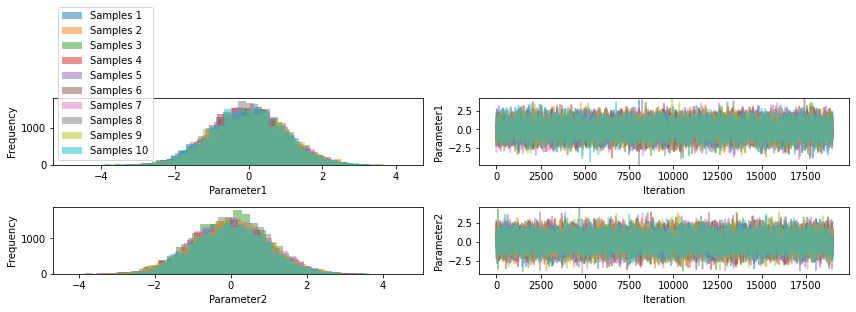

In [35]:
import matplotlib.pyplot as plt
import pints.plot

# Set warmup iterations
warmup = 1000

# Show summary
print(pints.MCMCSummary(chains=chains[:, warmup:]))

# Plot traces
fig = pints.plot.trace(chains[:, warmup:])
plt.show()

## Compare $\hat{R}$ statistics for different chain lengths

In [28]:
def _within(chains):
    # Get number of chains and number of parameters
    n_chains, _, n_parameters = chains.shape

    # Compute unbiased within-chain covariance estimate
    within_chain_cov = np.empty(shape=(n_chains, n_parameters, n_parameters))
    for chain_id, chain in enumerate(chains):
        within_chain_cov[chain_id] = np.cov(chain, ddof=1, rowvar=False)

    # Compute mean-within chain variance
    w = np.mean(within_chain_cov, axis=0)

    return w

def _between(chains):
    # Get number of samples
    n = chains.shape[1]

    # Compute within-chain mean
    within_chain_means = np.mean(chains, axis=1)

    # Compute covariance across chains of within-chain means
    between_chain_cov = np.cov(within_chain_means, ddof=1, rowvar=False)

    # Weight variance with number of samples per chain
    b = n * between_chain_cov

    return b

def multidimensional_rhat(chains):
    # Get number of samples
    n = chains.shape[1]

    # Split chains in half
    n = n // 2  # new length of chains
    if n < 1:
        raise ValueError(
            'Number of samples per chain after warm-up and chain splitting is '
            '%d. Method needs at least 1 sample per chain.' % n)
    chains = np.vstack([chains[:, :n], chains[:, -n:]])

    # Compute mean within-chain covariance
    w = _within(chains)

    # Compute mean between-chain convariance
    b = _between(chains)

    # Compute Rhat
    rhat = np.sqrt((n - 1.0) / n + np.linalg.det(b) / (np.linalg.det(w) * n))

    return rhat

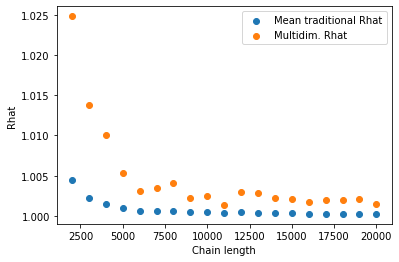

In [36]:
import numpy as np

# Define chain lengths for Rhat evaluation
warmup = 1000
chain_lengths = np.arange(start=2000, stop=21000, step=1000)

# Compute mean of traditional rhat
mean_traditional_rhats = [np.mean(pints.rhat(chains[:, warmup:chain_length])) for chain_length in chain_lengths]

# Compute multidimensional rhat
multidim_rhats = [multidimensional_rhat(chains[:, warmup:chain_length]) for chain_length in chain_lengths]

# Plot evolution of rhat
plt.scatter(x=chain_lengths, y=mean_traditional_rhats, label='Mean traditional Rhat')
plt.scatter(x=chain_lengths, y=multidim_rhats, label='Multidim. Rhat')
plt.xlabel('Chain length')
plt.ylabel('Rhat')
plt.legend()
plt.show()

## Visually inspect convergence

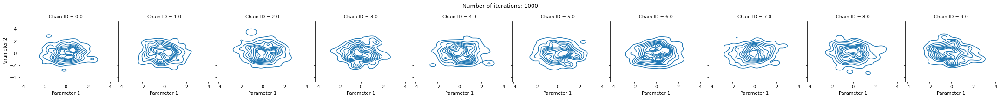

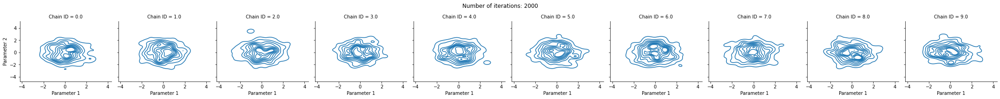

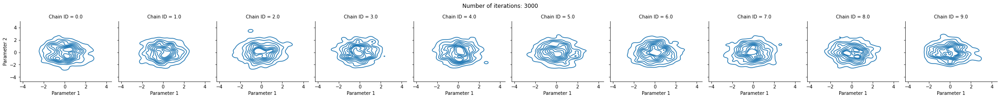

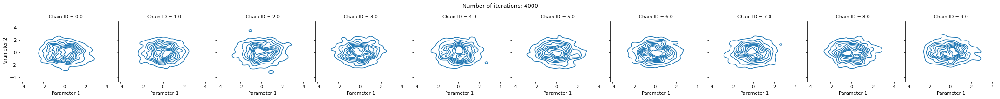

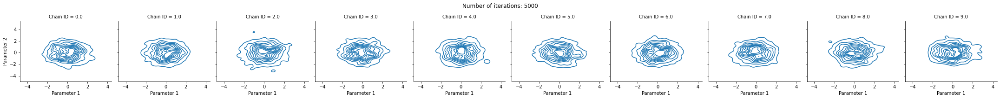

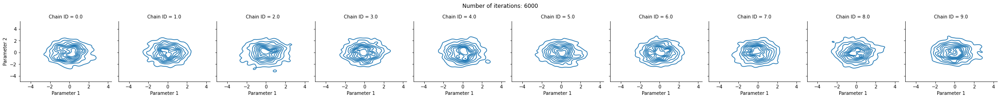

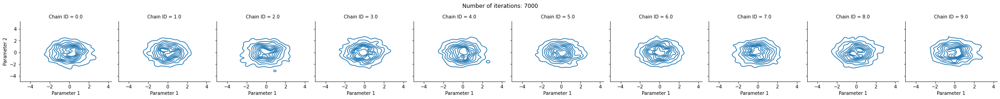

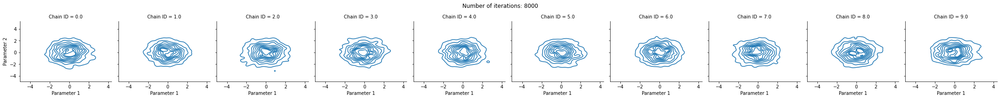

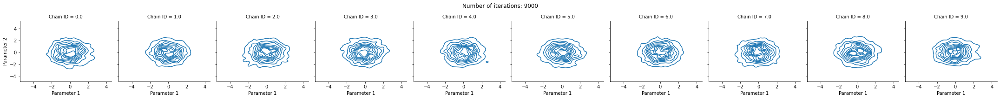

In [59]:
import pandas as pd
import seaborn as sns

# Define chain lengths for Rhat evaluation
warmup = 1000
n_chains = 10
chain_lengths = np.arange(start=1000, stop=10000, step=1000)

# Create 2 dim histogram for each chain
for chain_length in chain_lengths:
    # Reshape chains to parse them into dataframe
    reshaped = np.empty(shape=(chain_length*n_chains, 3))
    start = 0
    for chain_id, chain in enumerate(chains[:, warmup:warmup+chain_length]):
        # Compute range of values
        end = start + chain_length

        # Set parameter 1 and 2
        reshaped[start:end, 0] = chain[:, 0]
        reshaped[start:end, 1] = chain[:, 1]

        # Set chain ID
        reshaped[start:end, 2] = chain_id

        # Shift start
        start = end

    # Convert to pandas dataframe for plotting
    df = pd.DataFrame(columns=['Parameter 1', 'Parameter 2', 'Chain ID'])
    df = df.append(pd.DataFrame({
        'Parameter 1': reshaped[:, 0],
        'Parameter 2': reshaped[:, 1],
        'Chain ID': reshaped[:, 2]}))

    # Create a facet grid
    g = sns.FacetGrid(df, col="Chain ID")

    # Add 2 dim histograms for all chains
    g.map(sns.kdeplot, 'Parameter 1', 'Parameter 2')

    # Set title 
    plt.subplots_adjust(top=0.8)
    g.fig.suptitle('Number of iterations: %d' % chain_length)
    plt.show()

## Compare KL divergence estimates

In [3]:
import numpy as np

def compute_kullback_leibler_divergence(log_pdf, chain, n_samples, seed):
    r"""
    Computes the KL divergence by sampling from the true log-pdf.

    :math:`n` samples are drawn from the true log-pdf and the divergence
    is approximated by 

    .. math::
            \hat{D}(f || g) \approx \frac{1}{n}
            \sum _{i=1}^n \log \frac{f(x_i)}{g(x_i)}.

    Parameters
    ----------
    log_pdf
        Exact log-pdf from which parameters can be sampled and the log_pdf 
        score can be computed.
    chain
        Chain draws in shape (n_draws, n_parameters)
    n_samples
        Number of samples drawn from the log-pdf.
    seed
        Seed for the random samples from the log-pdf
    """
    # Draw parameter samples
    np.random.seed(seed)
    samples = log_pdf.sample(n=n_samples)

    # Compute log-pdf score
    true_scores = np.empty(shape=n_samples)
    for sample_id, sample in enumerate(samples):
        true_scores[sample_id] = log_pdf(sample)

    # Compute scores from inferred distribution
    approximate_pdf = stats.gaussian_kde(chain.T)
    inferred_scores = np.log(approximate_pdf.evaluate(samples.T))

    # Estimate KLD
    kld = np.mean(true_scores - inferred_scores)

    return kld

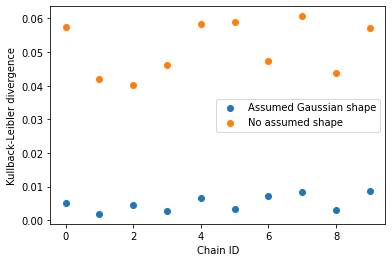

In [4]:
from scipy import stats

# Compute approximate Kullback-Leiber divergence assuming a Gaussian shape
gaussian_klds = [normal_log_pdf.kl_divergence(chain) for chain in chains[:, warmup:]]

# Compute approximate Kullback-Leibler divergence with asymptotically correct expression
seed = 1
n_samples = 10000
asymptotic_klds = [
    compute_kullback_leibler_divergence(
        normal_log_pdf, chain, n_samples=n_samples, seed=seed) 
    for chain in chains[:, warmup:]]

# Plot KLD estimates for each chain
chain_ids = np.arange(n_chains)
plt.scatter(x=chain_ids, y=gaussian_klds, label='Assumed Gaussian shape')
plt.scatter(x=chain_ids, y=asymptotic_klds, label='No assumed shape')
plt.xlabel('Chain ID')
plt.ylabel('Kullback-Leibler divergence')
plt.legend()
plt.show()

## Visualise differences to true distribution

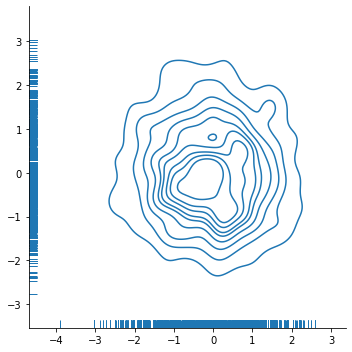

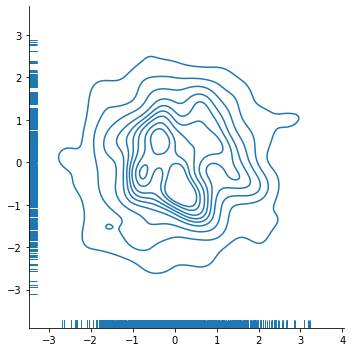

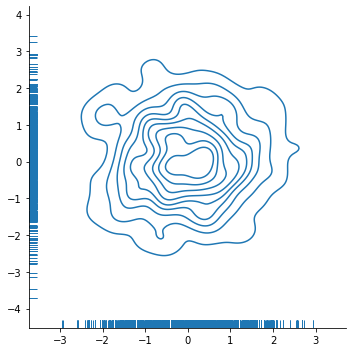

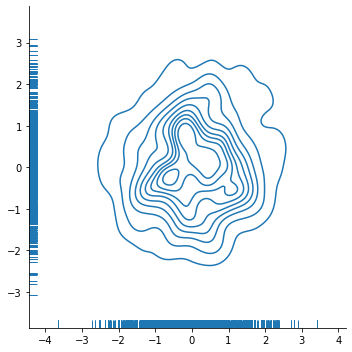

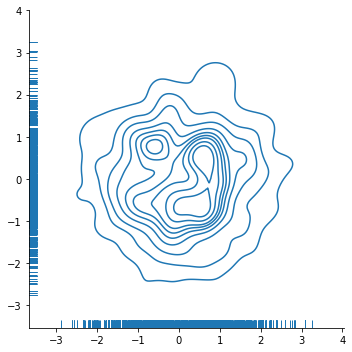

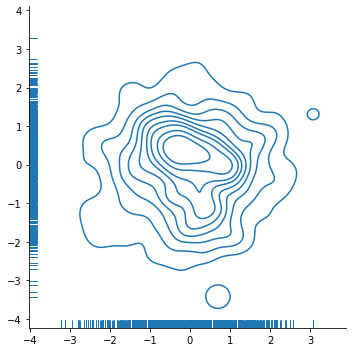

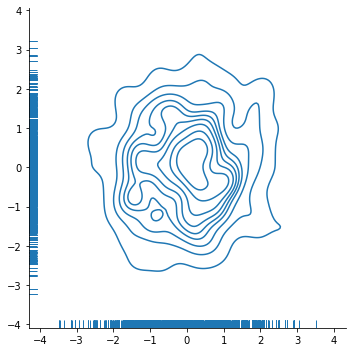

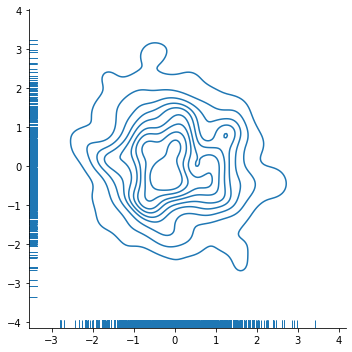

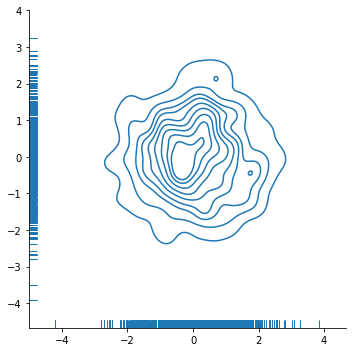

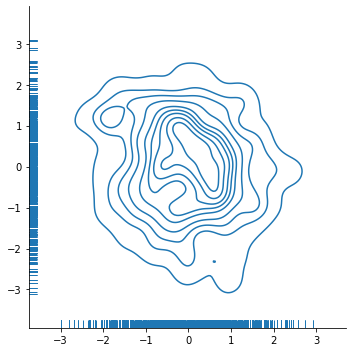

In [5]:
import seaborn as sns

# Visualise distributions for each chain
for chain in chains[:, warmup:]:
    sns.displot(x=chain[:, 0], y=chain[:, 1], kind="kde", rug=True)
    plt.show()

## Comparing all chains combined

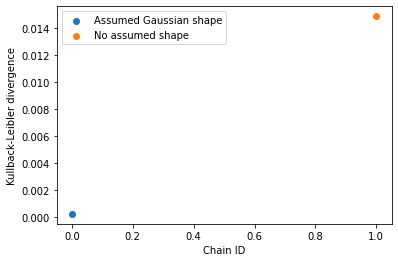

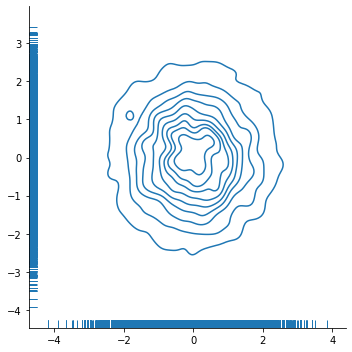

In [6]:
# Reshape chains
all_chains_x = chains[:, warmup:, 0].flatten()
all_chains_y = chains[:, warmup:, 1].flatten()
all_chains = np.vstack([all_chains_x, all_chains_y]).T

# Compute KL divergences
gaussian_kld = normal_log_pdf.kl_divergence(all_chains)

seed = 1
n_samples = 10000
asymptotic_kld = compute_kullback_leibler_divergence(
    normal_log_pdf, all_chains, n_samples=n_samples, seed=seed) 

# Plot KLD estimates for each chain
chain_ids = np.arange(n_chains)
plt.scatter(x=[0], y=[gaussian_kld], label='Assumed Gaussian shape')
plt.scatter(x=[1], y=[asymptotic_kld], label='No assumed shape')
plt.xlabel('Chain ID')
plt.ylabel('Kullback-Leibler divergence')
plt.legend()
plt.show()

# Plot all chains in one plot
sns.displot(x=all_chains_x, y=all_chains_y, kind="kde", rug=True)
plt.show()